<a href="https://colab.research.google.com/github/JeffWilliams2/Project/blob/main/DE_with_dlt.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Data Engineering for ETL: Data Ingestion with dlt**

While building the simple pipeline, Alexey had to manually handle **nested API calls**, **validate** and **transform** the data, define **schema**, and ensure proper **storage** in multiple formats. This process involved writing and debugging considerable boilerplate code, especially for managing API interactions and database integration. In this section, **we introduce dlt**, a tool that automates much of this work, including data typing, schema inference, and streamlined data ingestion, allowing you to focus on higher-level tasks.

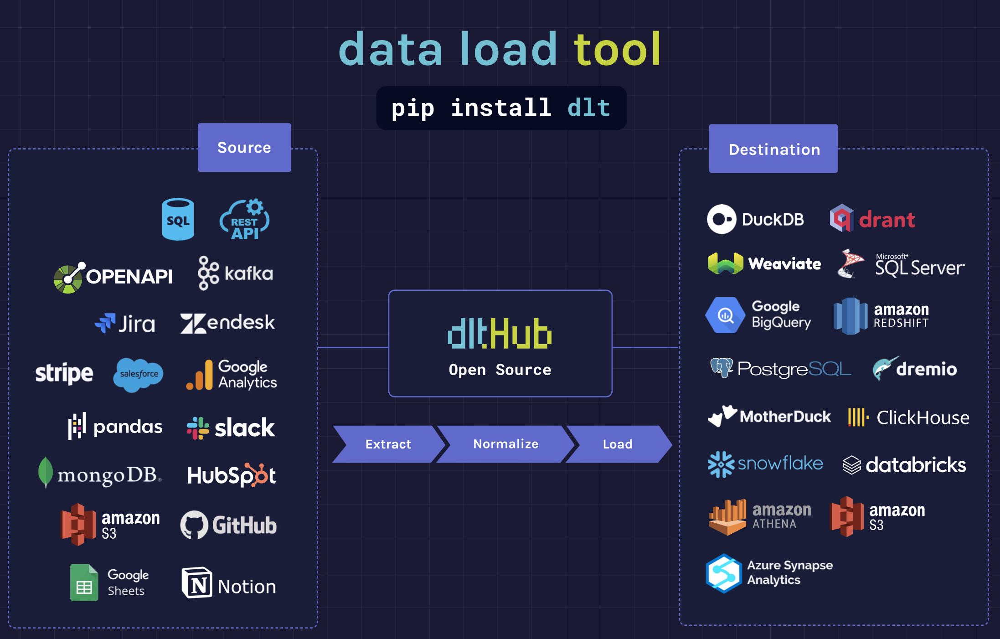

## **Introduction to dlt**

> "Why reinvent the wheel?"


**Goal:** Replace the manual pipeline built in the previous section with a streamlined pipeline powered by **dlt**. By leveraging dlt’s built-in features, you’ll see how to simplify data extraction, transformation, and loading with minimal boilerplate code.

1. **What is dlt?**
    - An open-source Python library that makes it easy to build data pipelines.
    - Simplifies data loading by handling schema management, incremental updates, retries, and more.
    - Similar to how dbt democratized the T layer of ELT with SQL, dltHub democratizes EL with Python.

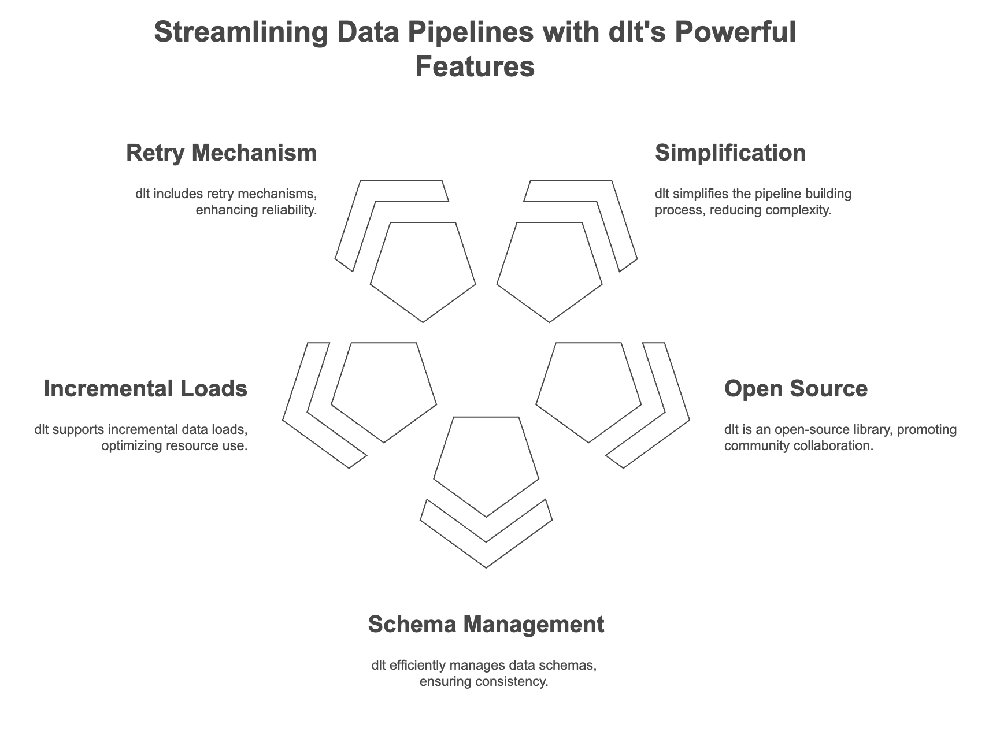

## **Install dlt**
[Install](https://dlthub.com/docs/reference/installation) dlt with DuckDB as destination:

In [ ]:
%%capture
!pip install "dlt[duckdb]"

## **Extracting data with dlt**

Extracting data from APIs manually requires handling
- **pagination**,
- **rate limits**,
- **authentication**,
- **errors**.

Instead of writing custom scripts, **[dlt](https://dlthub.com/)** simplifies the process with a built-in **[REST API Client](https://dlthub.com/docs/general-usage/http/rest-client)**, making extraction **efficient, scalable, and reliable**.  

## **What is the dlt Rest Client?**
It's a declarative API client that can handle:
- automatic pagination
- various authentication mechanisms
- customizable request/response
- retries
---

### **Why use dlt for extraction?**  

✅ **Built-in REST API support** – Extract data from APIs with minimal code.  
✅ **Automatic pagination handling** – No need to loop through pages manually.  
✅ **Manages Rate Limits & Retries** – Prevents exceeding API limits and handles failures.  
✅ **Streaming support** – Extracts and processes data without loading everything into memory.  
✅ **Seamless integration** – Works with **normalization and loading** in a single pipeline.  



### **Example: extracting data with dlt**  

Let's first recall how data extraction from API was implemented without dlt.

### Recap: In the previous part

📌 Example:

>In this example, we’ll request data from [GitHub API](https://docs.github.com/en/rest/quickstart?apiVersion=2022-11-28).

When calling a GitHub API endpoint, such as fetching events from the `data-engineering-zoomcamp` repository, GitHub paginates the results, meaning it returns only a limited number of records per request. By default, this is **30 results per page**, even if more data is available. To get all results, we need to request additional pages until there are no more left.

**API [documentation](https://docs.github.com/en/rest/activity/events?apiVersion=2022-11-28#list-repository-events)**:  
- **Endpoint**: `/repos/{owner}/{repo}/events`, lists repository events.
- **Data**: List of dicts. Comes in pages of 30 records.  
- **Pagination**: When there’s no more data, the API returns no links to the next page.  
- **Details**:  
  - **Method**: GET  
  - **URL**: `https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp/events`  
  - **Parameters**:  
    - `page`: Integer (page number), defaults to 1.
    - `per_page`: The number of results per page (max 100). Defaults to 30.  

>When a response is paginated, the response headers will include a `link` header. If the endpoint does not support pagination, or if all results fit on a single page, the link header will be omitted.
>
>The link header contains URLs that you can use to fetch additional pages of results. For example, the previous, next, first, and last page of results.


This script demonstrates how to handle paginated responses by automatically requesting the next page of data until all pages are retrieved:

In [ ]:
import requests
from google.colab import userdata

API_TOKEN = userdata.get('ACCESS_TOKEN')
BASE_URL = "https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp/events"


def paginated_getter():
    page_number = 1
    url = BASE_URL

    # Iterate over pages
    while True:
        # Starts at **page 1** and makes a **GET request** to the API.
        response = requests.get(url, headers={"Authorization": f"Bearer {API_TOKEN}"})
        # Retrieves **JSON data**.
        page_data = response.json()
        yield page_data

        # Looks for the **"next" page URL** in the response headers.
        next_page = response.links.get("next", {}).get("url")


        # If there’s **no next page**, stops fetching and ends the loop.
        if not next_page:
            break

        # If a **next page exists**, updates `BASE_URL` and requests more data.
        page_number += 1
        url = next_page


for page_data in paginated_getter():
    print(page_data)

**What happens here:**  

- Starts at **page 1** and makes a **GET request** to the API.  
- Retrieves **JSON data**.  
- Looks for the **"next" page URL** in the response headers.  
- If a **next page exists**, updates `BASE_URL` and requests more data.  
- If there’s **no next page**, stops fetching and ends the loop.

Now, let’s use dlt’s **RESTClient** to extract the same data, while exploring how it manages authentication and handles pagination automatically:

In [ ]:
import dlt
from dlt.sources.helpers.rest_client import RESTClient
from dlt.sources.helpers.rest_client.auth import BearerTokenAuth
from dlt.sources.helpers.rest_client.paginators import HeaderLinkPaginator
from google.colab import userdata

API_TOKEN = userdata.get('ACCESS_TOKEN')


def paginated_getter():
    client = RESTClient(
        base_url="https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp/",
        auth=BearerTokenAuth(token=API_TOKEN),
        paginator=HeaderLinkPaginator(links_next_key="next"), #if paginator is not explicitly provided, dlt can automatically detect the pagination type required
    )

    for page in client.paginate("events"):    # <--- API endpoint for retrieving events data
        yield page   # remember about memory management and yield data


for page_data in paginated_getter():
    print(page_data)

[{'id': '49646534500', 'type': 'ForkEvent', 'actor': {'id': 108245743, 'login': 'Garretthall27', 'display_login': 'Garretthall27', 'gravatar_id': '', 'url': 'https://api.github.com/users/Garretthall27', 'avatar_url': 'https://avatars.githubusercontent.com/u/108245743?'}, 'repo': {'id': 419661684, 'name': 'DataTalksClub/data-engineering-zoomcamp', 'url': 'https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp'}, 'payload': {'forkee': {'id': 982570234, 'node_id': 'R_kgDOOpDU-g', 'name': 'data-engineering-zoomcamp', 'full_name': 'Garretthall27/data-engineering-zoomcamp', 'private': False, 'owner': {'login': 'Garretthall27', 'id': 108245743, 'node_id': 'U_kgDOBnOy7w', 'avatar_url': 'https://avatars.githubusercontent.com/u/108245743?v=4', 'gravatar_id': '', 'url': 'https://api.github.com/users/Garretthall27', 'html_url': 'https://github.com/Garretthall27', 'followers_url': 'https://api.github.com/users/Garretthall27/followers', 'following_url': 'https://api.github.com/users/Ga

**Authentication** <br>
The RESTClient supports various [authentication strategies](https://dlthub.com/docs/general-usage/http/rest-client#authentication) through the auth parameter:
- BearerTokenAuth
- APIKeyAuth
- HttpBasicAuth
- OAuth2ClientCredentials

**Paginators** <br>
Paginators are used to handle paginated responses. The RESTClient class comes with [built-in paginators](https://dlthub.com/docs/general-usage/http/rest-client#paginators) for common pagination mechanisms: <br>
- JSONLinkPaginator - link to the next page is included in the JSON response.
- HeaderLinkPaginator - link to the next page is included in the response headers.
- OffsetPaginator - pagination based on offset and limit query parameters.
- PageNumberPaginator - pagination based on page numbers.
- JSONResponseCursorPaginator - pagination based on a cursor in the JSON response.
- HeaderCursorPaginator - pagination based on a cursor in the response headers.



**How dlt simplifies API extraction:**  

🔹 **No manual pagination** – dlt **automatically** fetches **all pages** of data.  
🔹 **Low memory usage** – Streams data **chunk by chunk**, avoiding RAM overflows.  
🔹 **Handles rate limits & retries** – Ensures requests are sent efficiently **without failures**.  
🔹 **Flexible destination support** – Load extracted data into **databases, warehouses, or data lakes**.  


### **dlt Resources**
- A [resource](https://dlthub.com/docs/general-usage/resource) is a function that yields data.
- To create a resource, we add the @dlt.resource decorator to that function.
- It allows for customization (e.g., naming, primary keys, incremental loading, parallel execution) which simplifies integration into data pipelines.

Let's declare a resource for the previous example using the @dlt.resource decorator:

In [ ]:
import dlt
from dlt.sources.helpers.rest_client import RESTClient
from dlt.sources.helpers.rest_client.auth import BearerTokenAuth
from dlt.sources.helpers.rest_client.paginators import HeaderLinkPaginator
from google.colab import userdata

API_TOKEN = userdata.get('ACCESS_TOKEN')


@dlt.resource(name="events", write_disposition="replace") # <--- The name of the resource (will be used as the table name)
def paginated_getter():
    client = RESTClient(
        base_url="https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp/",
        auth=BearerTokenAuth(token=API_TOKEN),
        paginator=HeaderLinkPaginator(links_next_key="next"),
    )

    for page in client.paginate("events"):
        yield page


for page_data in paginated_getter():
    print(page_data)

Commonly used arguments:

* **name**: The resource name and the name of the table generated by this resource. Defaults to the decorated function name.
* **table_name**: the name of the table, if different from the resource name.
* **[write_disposition](https://dlthub.com/docs/general-usage/incremental-loading#the-3-write-dispositions)**: controls how to write data to a table. Defaults to "append". (We will look more into this topic later in Loading data with dlt)

> **Why is it a better way?** This allows you to use `dlt` functionalities to the fullest that follow Data Engineering best practices, including incremental loading and data contracts.

### **dlt configuration and secrets**

In dlt, [configurations and secrets](https://dlthub.com/docs/general-usage/credentials/) are essential for setting up data pipelines.

**Configurations** are **non-sensitive** settings that define the behavior of a data pipeline, including file paths, database hosts, timeouts, API URLs, and performance settings.

On the other hand, **secrets** are **sensitive** data like passwords, API keys, and private keys, which should never be hard-coded to avoid security risks.

These can be set up in various ways:

* Environment variables
* In code using `dlt.secrets` and `dlt.config`
* Configuration files (`secrets.toml` and `config.toml`)

We're gonna use `dlt.secrets.value` to define credentials in resources and sources. dlt automatically **extracts** configuration settings and secrets based on flexible naming conventions. It then **injects** these values where needed in code.

**Note**: It's important to note that while you can put all configurations and credentials in the `dlt.secrets` (or `secrets.toml`) if it's more convenient, credentials cannot be placed in `dlt.config` (or `config.toml`) because dlt doesn't look for them there.


In [ ]:
import os
import dlt
from dlt.sources.helpers.rest_client import RESTClient
from dlt.sources.helpers.rest_client.auth import BearerTokenAuth
from dlt.sources.helpers.rest_client.paginators import HeaderLinkPaginator
from google.colab import userdata

os.environ["ACCESS_TOKEN"] = userdata.get('ACCESS_TOKEN') # <--- set ENV in the special format: uppercase secret name
events_data = []


@dlt.resource(name="events")
def paginated_getter(
    access_token=dlt.secrets.value  # <--- set the secret variable "access_token" here
):
    client = RESTClient(
        base_url="https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp/",
        auth=BearerTokenAuth(token=access_token), # <--- use the variable "access_token" as usual
        paginator=HeaderLinkPaginator(links_next_key="next"),
    )

    for page in client.paginate("events"):
        yield page


for page_data in paginated_getter():
    events_data.append(page_data)
    print(page_data)

{'id': '49647445080', 'type': 'WatchEvent', 'actor': {'id': 44624855, 'login': 'Simon-Blamo', 'display_login': 'Simon-Blamo', 'gravatar_id': '', 'url': 'https://api.github.com/users/Simon-Blamo', 'avatar_url': 'https://avatars.githubusercontent.com/u/44624855?'}, 'repo': {'id': 419661684, 'name': 'DataTalksClub/data-engineering-zoomcamp', 'url': 'https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp'}, 'payload': {'action': 'started'}, 'public': True, 'created_at': '2025-05-13T05:41:41Z', 'org': {'id': 72699292, 'login': 'DataTalksClub', 'gravatar_id': '', 'url': 'https://api.github.com/orgs/DataTalksClub', 'avatar_url': 'https://avatars.githubusercontent.com/u/72699292?'}}
{'id': '49646534500', 'type': 'ForkEvent', 'actor': {'id': 108245743, 'login': 'Garretthall27', 'display_login': 'Garretthall27', 'gravatar_id': '', 'url': 'https://api.github.com/users/Garretthall27', 'avatar_url': 'https://avatars.githubusercontent.com/u/108245743?'}, 'repo': {'id': 419661684, 'name

## **Normalizing data with dlt**  

**Why Use dlt for normalization?**  

✅ **Automatically detects schema** – No need to define column types manually.  
✅ **Flattens nested JSON** – Converts complex structures into table-ready formats.  
✅ **Handles data type conversion** – Converts dates, numbers, and booleans correctly.  
✅ **Splits lists into child tables** – Ensures relational integrity for better analysis.  
✅ **Schema evolution support** – Adapts to changes in data structure over time.  

---

### **Example**  

Let's extract events data from the previous example, which contains **nested dictionaries** and **lists**:  


In [ ]:
#let's look at an event containing nested dictionaries and list
events_data[6]

{'id': '49589790887',
 'type': 'PullRequestEvent',
 'actor': {'id': 83577461,
  'login': 'Joyan9',
  'display_login': 'Joyan9',
  'gravatar_id': '',
  'url': 'https://api.github.com/users/Joyan9',
  'avatar_url': 'https://avatars.githubusercontent.com/u/83577461?'},
 'repo': {'id': 419661684,
  'name': 'DataTalksClub/data-engineering-zoomcamp',
  'url': 'https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp'},
 'payload': {'action': 'closed',
  'number': 724,
  'pull_request': {'url': 'https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp/pulls/724',
   'id': 2439999496,
   'node_id': 'PR_kwDOGQOHdM6Rb3AI',
   'html_url': 'https://github.com/DataTalksClub/data-engineering-zoomcamp/pull/724',
   'diff_url': 'https://github.com/DataTalksClub/data-engineering-zoomcamp/pull/724.diff',
   'patch_url': 'https://github.com/DataTalksClub/data-engineering-zoomcamp/pull/724.patch',
   'issue_url': 'https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp

### **How dlt normalizes this data automatically**  

Instead of manually flattening fields and extracting nested lists, we can **load it directly into DuckDB**:

In [ ]:
import dlt

# Define a dlt pipeline with automatic normalization
pipeline = dlt.pipeline(
    pipeline_name="github_data",
    destination="duckdb",
    dataset_name="events",
)

# Run the pipeline with raw nested data
info = pipeline.run(paginated_getter, table_name="events", write_disposition="replace")

# Print the load summary
print(info)

Pipeline github_data load step completed in 1.53 seconds
1 load package(s) were loaded to destination duckdb and into dataset events
The duckdb destination used duckdb:////content/github_data.duckdb location to store data
Load package 1747049740.3913822 is LOADED and contains no failed jobs


In [ ]:
#print all the tables which were created
print(pipeline.dataset(dataset_type="default").schema.data_table_names())

['events', 'events__payload__pull_request__base__repo__topics']


You can see from the output above, dlt dynamically creates child tables (events__payload__pull_request__base__repo__topics) when it encounters a List in JSON

In [ ]:
#print events table
pipeline.dataset(dataset_type="default").events.df()

,id,type,actor__id,actor__login,actor__display_login,actor__gravatar_id,actor__url,actor__avatar_url,repo__id,repo__name,...,payload__pull_request__rebaseable,payload__pull_request__mergeable_state,payload__pull_request__comments,payload__pull_request__review_comments,payload__pull_request__maintainer_can_modify,payload__pull_request__commits,payload__pull_request__additions,payload__pull_request__deletions,payload__pull_request__changed_files,payload__pull_request__head__repo__language
0,49609884391,WatchEvent,98219779,messey4,messey4,,https://api.github.com/users/messey4,https://avatars.githubusercontent.com/u/98219779?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
1,49608972123,WatchEvent,111129786,ZohaibJavaid32,ZohaibJavaid32,,https://api.github.com/users/ZohaibJavaid32,https://avatars.githubusercontent.com/u/111129...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
2,49598659783,WatchEvent,111562450,Ramakrishna-23,Ramakrishna-23,,https://api.github.com/users/Ramakrishna-23,https://avatars.githubusercontent.com/u/111562...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
3,49595002764,WatchEvent,70075254,yaohong010,yaohong010,,https://api.github.com/users/yaohong010,https://avatars.githubusercontent.com/u/70075254?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
4,49593229688,ForkEvent,65704481,tejaswininakirekanti,tejaswininakirekanti,,https://api.github.com/users/tejaswininakirekanti,https://avatars.githubusercontent.com/u/65704481?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
290,49119364376,WatchEvent,128820055,idayyy7,idayyy7,,https://api.github.com/users/idayyy7,https://avatars.githubusercontent.com/u/128820...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
291,49119253573,WatchEvent,66335989,Jonathanyun,Jonathanyun,,https://api.github.com/users/Jonathanyun,https://avatars.githubusercontent.com/u/66335989?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
292,49117451163,ForkEvent,69591619,SyuTengChang,SyuTengChang,,https://api.github.com/users/SyuTengChang,https://avatars.githubusercontent.com/u/69591619?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
293,49117059853,WatchEvent,77876802,luckfalcon,luckfalcon,,https://api.github.com/users/luckfalcon,https://avatars.githubusercontent.com/u/77876802?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None


In [ ]:
#print the child table
pipeline.dataset(dataset_type="default").events__payload__pull_request__base__repo__topics.df()

,value,_dlt_parent_id,_dlt_list_idx,_dlt_id
0,data-engineering,4F5xnEPtWLcvGg,0,/AytEUs80Y/M/Q
1,dbt,4F5xnEPtWLcvGg,1,DjaEq3fAriz+1A
2,docker,4F5xnEPtWLcvGg,2,6CnnfthB8qZECA
3,kafka,4F5xnEPtWLcvGg,3,GI71OTLOHKgafQ
4,kestra,4F5xnEPtWLcvGg,4,38pa4cSmR2KE8w
5,spark,4F5xnEPtWLcvGg,5,dcc8V4YAsRNlqQ
6,data-engineering,kIbH+5bAt8LKLg,0,GIO2AC1hPbzRXA
7,dbt,kIbH+5bAt8LKLg,1,5TErUucG4wEO7A
8,docker,kIbH+5bAt8LKLg,2,6CQ7NbuDpZ7jyg
9,kafka,kIbH+5bAt8LKLg,3,qEwVsy6NU13gOg


In [ ]:
# use dlt's sql_client to query data: All events which had a child table created
sql = """
SELECT *
FROM events e
JOIN events__payload__pull_request__base__repo__topics c
ON e._dlt_id = c._dlt_parent_id
"""
with pipeline.sql_client() as client:
    with client.execute_query(sql) as cursor:
        data = cursor.df()
data

,id,type,actor__id,actor__login,actor__display_login,actor__gravatar_id,actor__url,actor__avatar_url,repo__id,repo__name,...,payload__pull_request__maintainer_can_modify,payload__pull_request__commits,payload__pull_request__additions,payload__pull_request__deletions,payload__pull_request__changed_files,payload__pull_request__head__repo__language,value,_dlt_parent_id,_dlt_list_idx,_dlt_id_1
0,49589790887,PullRequestEvent,83577461,Joyan9,Joyan9,,https://api.github.com/users/Joyan9,https://avatars.githubusercontent.com/u/83577461?,419661684,DataTalksClub/data-engineering-zoomcamp,...,False,1,1,1,1,None,spark,4F5xnEPtWLcvGg,5,dcc8V4YAsRNlqQ
1,49419771790,PullRequestEvent,108355948,pizofreude,pizofreude,,https://api.github.com/users/pizofreude,https://avatars.githubusercontent.com/u/108355...,419661684,DataTalksClub/data-engineering-zoomcamp,...,True,2,4,4,1,Jupyter Notebook,spark,kIbH+5bAt8LKLg,5,uvZpydEe1hGJzQ
2,49325481946,PullRequestEvent,39490719,plpcout,plpcout,,https://api.github.com/users/plpcout,https://avatars.githubusercontent.com/u/39490719?,419661684,DataTalksClub/data-engineering-zoomcamp,...,True,1,6,6,4,Jupyter Notebook,spark,MOqc9lfuFa/l9w,5,UgjMf7bK4LsdEQ
3,49589790887,PullRequestEvent,83577461,Joyan9,Joyan9,,https://api.github.com/users/Joyan9,https://avatars.githubusercontent.com/u/83577461?,419661684,DataTalksClub/data-engineering-zoomcamp,...,False,1,1,1,1,None,kestra,4F5xnEPtWLcvGg,4,38pa4cSmR2KE8w
4,49419771790,PullRequestEvent,108355948,pizofreude,pizofreude,,https://api.github.com/users/pizofreude,https://avatars.githubusercontent.com/u/108355...,419661684,DataTalksClub/data-engineering-zoomcamp,...,True,2,4,4,1,Jupyter Notebook,kestra,kIbH+5bAt8LKLg,4,kTgEgpIG0cZvrA
5,49325481946,PullRequestEvent,39490719,plpcout,plpcout,,https://api.github.com/users/plpcout,https://avatars.githubusercontent.com/u/39490719?,419661684,DataTalksClub/data-engineering-zoomcamp,...,True,1,6,6,4,Jupyter Notebook,kestra,MOqc9lfuFa/l9w,4,dBhr78ICAgTD/Q
6,49589790887,PullRequestEvent,83577461,Joyan9,Joyan9,,https://api.github.com/users/Joyan9,https://avatars.githubusercontent.com/u/83577461?,419661684,DataTalksClub/data-engineering-zoomcamp,...,False,1,1,1,1,None,kafka,4F5xnEPtWLcvGg,3,GI71OTLOHKgafQ
7,49419771790,PullRequestEvent,108355948,pizofreude,pizofreude,,https://api.github.com/users/pizofreude,https://avatars.githubusercontent.com/u/108355...,419661684,DataTalksClub/data-engineering-zoomcamp,...,True,2,4,4,1,Jupyter Notebook,kafka,kIbH+5bAt8LKLg,3,qEwVsy6NU13gOg
8,49325481946,PullRequestEvent,39490719,plpcout,plpcout,,https://api.github.com/users/plpcout,https://avatars.githubusercontent.com/u/39490719?,419661684,DataTalksClub/data-engineering-zoomcamp,...,True,1,6,6,4,Jupyter Notebook,kafka,MOqc9lfuFa/l9w,3,k9wcj+ZxzV/ZJg
9,49589790887,PullRequestEvent,83577461,Joyan9,Joyan9,,https://api.github.com/users/Joyan9,https://avatars.githubusercontent.com/u/83577461?,419661684,DataTalksClub/data-engineering-zoomcamp,...,False,1,1,1,1,None,docker,4F5xnEPtWLcvGg,2,6CnnfthB8qZECA


In [ ]:
# Print the default schema in a pretty YAML format
print(pipeline.default_schema.to_pretty_yaml())

version: 2
version_hash: OlSadKK9HPUKjFSA/JvJ9gF6Xg5xdeeheZTTgp3JUy0=
engine_version: 11
name: github_data
tables:
  _dlt_version:
    columns:
      version:
        data_type: bigint
        nullable: false
      engine_version:
        data_type: bigint
        nullable: false
      inserted_at:
        data_type: timestamp
        nullable: false
      schema_name:
        data_type: text
        nullable: false
      version_hash:
        data_type: text
        nullable: false
      schema:
        data_type: text
        nullable: false
    write_disposition: skip
    resource: _dlt_version
    description: Created by DLT. Tracks schema updates
  _dlt_loads:
    columns:
      load_id:
        data_type: text
        nullable: false
      schema_name:
        data_type: text
        nullable: true
      status:
        data_type: bigint
        nullable: false
      inserted_at:
        data_type: timestamp
        nullable: false
      schema_version_hash:
        data_type: te

### Adjusting the normalization

This can be done in a couple of ways:

You can customise how resources handle nested data via max_table_nesting https://dlthub.com/docs/general-usage/resource#reduce-the-nesting-level-of-generated-tables <br>
dlt infers and saves a schema from the data, which also contains configuration for the normalizer, which can be adjusted https://dlthub.com/docs/walkthroughs/adjust-a-schema <br>

### Setting a data contract

Finally, we can use the data contract functionality to fix a schema and use it use as a data contract - this can be configured to prevent the automatic schema evolution. https://dlthub.com/docs/general-usage/schema-contracts

In [ ]:
# example data contract
@dlt.resource(schema_contract={"tables": "discard_row", "columns": "freeze", "data_type": "evolve"})
def events():
    ...

### Setting up the contract

You can control the following schema entities:

- tables - the contract is applied when a new table is created
- columns - the contract is applied when a new column is created on an existing table
- data_type - the contract is applied when data cannot be coerced into a data type associated with an existing column

You can use contract modes to tell dlt how to apply the contract for a particular entity:

- evolve: No constraints on schema changes.
- freeze: This will raise an exception if data is encountered that does not fit the existing schema, so no data will be loaded to the destination.
- discard_row: This will discard any extracted row if it does not adhere to the existing schema, and this row will not be loaded to the destination.
- discard_value: This will discard data in an extracted row that does not adhere to the existing schema, and the row will be loaded without this data.

### Step by step
- Load data and set a contract
- Add a column to the incoming data set (append in py) and see it get rejected
- Remove the contract and see it get accepted

In [ ]:
import dlt
from dlt.sources.helpers.rest_client import RESTClient
from dlt.sources.helpers.rest_client.auth import BearerTokenAuth
from dlt.sources.helpers.rest_client.paginators import HeaderLinkPaginator
from google.colab import userdata

BASE_URL = "https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp"
API_TOKEN = userdata.get('ACCESS_TOKEN')

@dlt.resource(schema_contract={"tables": "evolve", "columns": "freeze", "data_type": "evolve"})
def paginated_getter():
  client = RESTClient(
      base_url=BASE_URL,
      auth=BearerTokenAuth(token=API_TOKEN),  # type: ignore
      paginator=HeaderLinkPaginator(links_next_key="next"),
  )

  for page in client.paginate("/events"):
    for record in page:
      #record['new_col2']='a' #uncomment this line after running it once - this will raise an exception since it creates a new column as we have set "columns": "freeze"
      yield record

#for record in paginated_getter():
#  print(record)


# Define a dlt pipeline with automatic normalization
pipeline = dlt.pipeline(
    pipeline_name="github_data_contract",
    destination="duckdb",
    dataset_name="events_contract",
)

# Run the pipeline with raw nested data
info = pipeline.run(paginated_getter(), table_name="events", write_disposition="replace")

# Print the load summary
print(info)

Pipeline github_data_contract load step completed in 2.42 seconds
1 load package(s) were loaded to destination duckdb and into dataset events_contract
The duckdb destination used duckdb:////content/github_data_contract.duckdb location to store data
Load package 1747129402.3930466 is LOADED and contains no failed jobs


### Alerting schema changes

If you are loading your data to a raw staging layer, you might just want to load everything that comes, and be alerted of schema evolution.

docs: https://dlthub.com/docs/general-usage/schema-evolution#alert-schema-changes-to-curate-new-data

### Step by step

1. Visit docs to copy the snippet
2. Adjust your code - load with a new pipeline to see the schema evolve.
3. Look at the emitted data and discuss how we could leverage that for lineage

In [ ]:
import dlt
from google.colab import userdata

API_TOKEN = userdata.get('ACCESS_TOKEN')
BASE_URL = "https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp"


from dlt.sources.helpers.rest_client import RESTClient
from dlt.sources.helpers.rest_client.auth import BearerTokenAuth
from dlt.sources.helpers.rest_client.paginators import HeaderLinkPaginator

@dlt.resource(name="events")
def paginated_getter():
  client = RESTClient(
      base_url=BASE_URL,
      auth=BearerTokenAuth(token=API_TOKEN),  # type: ignore
      paginator=HeaderLinkPaginator(links_next_key="next"),
  )


  for page in client.paginate("/events"):
      yield page


pipeline = dlt.pipeline(
    pipeline_name="github_data_evolved",
    destination="duckdb",
    dataset_name="events",
)

# Run the pipeline with raw nested data
load_info = pipeline.run(paginated_getter, table_name="events", write_disposition="replace")

for package in load_info.load_packages:
    # Iterate over each table in the schema_update of the current package
    for table_name, table in package.schema_update.items():
        # Iterate over each column in the current table
        for column_name, column in table["columns"].items():
          print(column_name, column , table)
            # Send a message to the Slack channel with the table

id {'name': 'id', 'data_type': 'text', 'nullable': True} {'columns': {'id': {'name': 'id', 'data_type': 'text', 'nullable': True}, 'type': {'name': 'type', 'data_type': 'text', 'nullable': True}, 'actor__id': {'name': 'actor__id', 'data_type': 'bigint', 'nullable': True}, 'actor__login': {'name': 'actor__login', 'data_type': 'text', 'nullable': True}, 'actor__display_login': {'name': 'actor__display_login', 'data_type': 'text', 'nullable': True}, 'actor__gravatar_id': {'name': 'actor__gravatar_id', 'data_type': 'text', 'nullable': True}, 'actor__url': {'name': 'actor__url', 'data_type': 'text', 'nullable': True}, 'actor__avatar_url': {'name': 'actor__avatar_url', 'data_type': 'text', 'nullable': True}, 'repo__id': {'name': 'repo__id', 'data_type': 'bigint', 'nullable': True}, 'repo__name': {'name': 'repo__name', 'data_type': 'text', 'nullable': True}, 'repo__url': {'name': 'repo__url', 'data_type': 'text', 'nullable': True}, 'payload__action': {'name': 'payload__action', 'data_type': '

This gives you visibility into schema changes, like:

- New columns added

- Possibly variant columns (e.g., column__str)

- Changes to data types (if tracked)

We explored how **dlt automatically handles data normalization**, transforming raw, nested JSON data into a structured, database-friendly format.

✅ **Nested structures were flattened** into separate columns, making querying easier.  
✅ **Lists were extracted into child tables**, preserving relationships between entities.  
✅ **Timestamps were converted to the correct format**, ensuring consistency.  

Instead of manually flattening data, handling schema changes, and ensuring relational integrity, dlt takes care of it all.  

---

### **Why dlt makes normalization easy**  
🔹 **No manual transformations needed** – Just load the raw data, and dlt does the rest!  
🔹 **Database-ready format** – Structured tables for efficient querying and analysis.  
🔹 **Handles schema evolution** – Adapts to new fields and schema changes without breaking pipelines.  
🔹 **Scales effortlessly** – Works seamlessly for both small datasets and large-scale pipelines.  

With dlt, you don’t need to worry about complex transformations or schema management—it happens automatically, so you can focus on extracting insights instead of wrangling data.  



---

Now that dlt has **automatically structured our raw data**, the next step is to **load it into a database or data lake** for analysis. With normalized tables ready, dlt ensures that data is **schema-consistent, optimized for querying, and linked correctly across tables**.  

💡 **Why not just load into a Pandas DataFrame?**  
While Pandas is great for small-scale data exploration, it **struggles with large datasets** due to memory constraints. Databases like **DuckDB, BigQuery, or Snowflake** allow **efficient querying, scalability, and persistence**, making them the right choice for production-grade data pipelines.  

Let’s see how dlt handles **efficient, resilient, and incremental data loading**—all with minimal setup!



---

## **Loading Data with dlt**  

With dlt, loading data **requires just a few lines of code** — schema inference, error handling, and incremental updates are all handled automatically!  


### **Why use dlt for loading?**  

✅ **Supports multiple destinations** – Load data into **BigQuery, Redshift, Snowflake, Postgres, DuckDB, Parquet (S3, GCS)** and more.  
✅ **Optimized for performance** – Uses **batch loading, parallelism, and streaming** for fast and scalable data transfer.  
✅ **Schema-aware** – Ensures that **column names, data types, and structures match** the destination’s requirements.  
✅ **Incremental loading** – Avoids unnecessary reloading by **only inserting new or updated records**.  
✅ **Resilience & retries** – Automatically handles failures, ensuring data is loaded **without missing records**.  
✅ **Atomic loading** – Ensures that data is fully written or rolled back to maintain consistency.


### Configure write disposition in resource, understanding how replace works
To leverage dlt fully, we give it end-to-end control over the data by using the @resource decorator at extraction, and the pipeline object for loading.

The pipeline can also load non-resource iterable objects like lists of dicts, panda frames, arrow tables, etc. but you benefit from the full capablities and scalability of dlt by wrapping the iterable with a @resource decorator. This gives you more configuration options, higher granularity of control, and core functionality.

A simple example: Most data sources have multiple resources. We can package multiple resources together into a @source function. Each @resource can have its own configuration, while the pipeline can load the @source and only configure the behavior for the entire contents of a source.

### Step by step:

1. Copy your code from the previous example
2. Change the write disposition declaration from pipeline to resource
3. Run it end to end with write disoposition "replace"
4. Discuss how Replace happens under the hood (it can be configured via dlt destination config)
https://dlthub.com/docs/general-usage/full-loading#choosing-the-correct-replace-strategy-for-your-full-load
  - default is "good enough for most cases"
  - you can sometimes set a more effective but risky mode
  - or you can choose a safer but slower and more expensive mode
5. Discuss pipeline last_trace and state


In [ ]:
import os
import dlt
from dlt.sources.helpers.rest_client import RESTClient
from dlt.sources.helpers.rest_client.auth import BearerTokenAuth
from dlt.sources.helpers.rest_client.paginators import HeaderLinkPaginator
from google.colab import userdata

API_TOKEN = userdata.get('ACCESS_TOKEN')

@dlt.resource(name="events", write_disposition="replace")  # <-- Set write_disposition here
def paginated_getter():
  client = RESTClient(
      base_url=BASE_URL,
      auth=BearerTokenAuth(token=API_TOKEN),  # type: ignore
      paginator=HeaderLinkPaginator(links_next_key="next"),
  )

  for page in client.paginate("events"):
        yield page


# define new dlt pipeline
pipeline = dlt.pipeline(
    pipeline_name='github_pipeline',
    destination="duckdb",
    dataset_name="events_dataset"
)

# run the pipeline with the new resource
load_info = pipeline.run(paginated_getter())  # <-- No need to specify write_disposition here

#print the event table
pipeline.dataset(dataset_type="default").events.df()


,id,type,actor__id,actor__login,actor__display_login,actor__gravatar_id,actor__url,actor__avatar_url,repo__id,repo__name,...,payload__pull_request__rebaseable,payload__pull_request__mergeable_state,payload__pull_request__comments,payload__pull_request__review_comments,payload__pull_request__maintainer_can_modify,payload__pull_request__commits,payload__pull_request__additions,payload__pull_request__deletions,payload__pull_request__changed_files,payload__pull_request__head__repo__language
0,49645016471,WatchEvent,106855879,eduardodfran,eduardodfran,,https://api.github.com/users/eduardodfran,https://avatars.githubusercontent.com/u/106855...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
1,49644480868,WatchEvent,171078571,swisski,swisski,,https://api.github.com/users/swisski,https://avatars.githubusercontent.com/u/171078...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
2,49642354053,WatchEvent,169910387,erictulda,erictulda,,https://api.github.com/users/erictulda,https://avatars.githubusercontent.com/u/169910...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
3,49640416287,WatchEvent,50531284,AgusScorti,AgusScorti,,https://api.github.com/users/AgusScorti,https://avatars.githubusercontent.com/u/50531284?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
4,49638223472,WatchEvent,13700786,thaismdr,thaismdr,,https://api.github.com/users/thaismdr,https://avatars.githubusercontent.com/u/13700786?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
290,49156667878,WatchEvent,24198955,vinayvemuri09,vinayvemuri09,,https://api.github.com/users/vinayvemuri09,https://avatars.githubusercontent.com/u/24198955?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
291,49154840911,WatchEvent,41014749,aFrankGin,aFrankGin,,https://api.github.com/users/aFrankGin,https://avatars.githubusercontent.com/u/41014749?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
292,49154455859,ForkEvent,57198715,habeeb3579,habeeb3579,,https://api.github.com/users/habeeb3579,https://avatars.githubusercontent.com/u/57198715?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
293,49153518661,WatchEvent,79005290,Kaiyue-Liu,Kaiyue-Liu,,https://api.github.com/users/Kaiyue-Liu,https://avatars.githubusercontent.com/u/79005290?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None


### Trace
A trace is a detailed record of the execution of a pipeline. It provides rich information on the pipeline processing steps: extract, normalize, and load. It also shows the last load_info.

In [ ]:
# print trace information
print(pipeline.last_trace)

Run started at 2025-05-13 08:51:34.039411+00:00 and COMPLETED in 5.45 seconds with 4 steps.
Step extract COMPLETED in 2.56 seconds.

Load package 1747126294.1263719 is EXTRACTED and NOT YET LOADED to the destination and contains no failed jobs

Step normalize COMPLETED in 0.13 seconds.
Normalized data for the following tables:
- events: 295 row(s)
- events__payload__pull_request__base__repo__topics: 18 row(s)
- _dlt_pipeline_state: 1 row(s)

Load package 1747126294.1263719 is NORMALIZED and NOT YET LOADED to the destination and contains no failed jobs

Step load COMPLETED in 2.68 seconds.
Pipeline github_pipeline load step completed in 2.66 seconds
1 load package(s) were loaded to destination duckdb and into dataset events_dataset
The duckdb destination used duckdb:////content/github_pipeline.duckdb location to store data
Load package 1747126294.1263719 is LOADED and contains no failed jobs

Step run COMPLETED in 5.45 seconds.
Pipeline github_pipeline load step completed in 2.66 second

In [ ]:
# print extract stage info
print(pipeline.last_trace.last_extract_info)
# print normalization stage info
print(pipeline.last_trace.last_normalize_info)
# print loading stage info
print(pipeline.last_trace.last_load_info)

After running this pipeline, dlt automatically transforms the data into the following normalized structure:

- Main table: `events`
- Child table: `events__payload__pull_request__base__repo__topics`
- Special table: `_dlt_pipeline_state` <br>

The `_dlt_pipeline_state` table, created by the dlt library in the destination dataset, stores the state of your pipeline. It contains information about the pipeline, the pipeline run, and a serialized version of the pipeline state. The state is stored locally in the pipeline working directory and is also stored at the destination for future runs.

Now, let's check which tables were created using:

In [ ]:
pipeline.dataset(dataset_type="default").schema.data_table_names()

['events', 'events__payload__pull_request__base__repo__topics']

This returns only two tables, but where is _dlt_pipeline_state? Why is it not listed, and how does dlt manage system tables differently from user tables?

`_dlt_pipeline_state` is a system table, and dlt separates data tables from internal metadata tables. To list system tables, use:

In [ ]:
pipeline.dataset(dataset_type="default").schema.dlt_table_names()

['_dlt_version', '_dlt_loads', '_dlt_pipeline_state']

`_dlt_pipeline_state` → Stores pipeline run state, checkpoints, and incremental progress.

`_dlt_loads` → Tracks load package history, including the load id, creation timestamp, and status, useful for tracking and debugging data loads.

`_dlt_version` → Stores the versions of your schemas.

Now, let’s take a quick look at `_dlt_pipeline_state` table that dlt creates to track the pipeline’s internal state.

In [ ]:
pipeline.dataset(dataset_type="default")._dlt_pipeline_state.df()

,version,engine_version,pipeline_name,state,created_at,version_hash,_dlt_load_id,_dlt_id
0,1,4,github_pipeline,eNpdj1FrwjAUhf/LfV0RB2qxsAdljoFzvs7JCLG5s9E0Lb...,2025-05-13 08:51:36.649511+00:00,6MOXBOD7z7mLw9Y5Ke+Mljo7vEEymZrFNwHx50AcK6A=,1747126294.1263719,pV42SbYvVFp4ag


The `_dlt_pipeline_state` table has the following fields:

- `version`: This field represents the version of the pipeline state.
- `engine_version`: This field represents the version of the dlt engine used.
- `pipeline_name`: This field stores the name of the pipeline.
- `state`: This field contains the serialized version of the pipeline state.
- `created_at`: This field stores the timestamp when the state was created.
- `version_hash`: This field contains a content-based hash that is updated each time the state is saved.
- `_dlt_load_id`: This field represents the ID of the load package.
- `_dlt_id`: This field is a unique identifier for the record.

# Incremental loading

## Understanding incremental Extract, State, and Write disposition

To master incremental loading, you need to understand the following concepts and how they relate:

Incremental loading is composed of keeping track of where we left off, incremental extraction and the specific way of adding or updating the increment to the destination - the write disposition


**- Incremental State**: A marker or checkpoint from the last load (like a timestamp or record ID) is maintained to track where the last extraction ended.

**- Incremental Extract:** Only new or changed data since the last extraction is processed, rather than the whole dataset. It needs the incremental state to know the increment boundaries.

**- Write Disposition**: Defines how new data is written (replace, append, merge)

### **How they work together:**

1. The **incremental state** tracks progress from the **last load.**

2. On pipeline run, the next **extract** checks **that state** to extract **only new data**. If this is the first run, you might provide starting "defaults" for the state.

3. After extraction, **write disposition** manages how data is inserted or replaced. The state is updated when the new increment is loaded.


Now, we can mix and match, and configure. Let's have a look at dlt incremental loading docs
https://dlthub.com/docs/general-usage/incremental-loading

As you can see, there are multiple ways to put it together. Let's do it for our example.

### Step by step: incremental loading with a cursor field

One way to configure our incremental extraction together with state is via a **cursor** field.

Most REST APIs and data sources allow you to fetch only new or updated records by sending the last known timestamp or ID, or what we call a **cursor** field. Here's how it works:

1. Identify the Cursor Field: Find the field that tracks changes (for example, "created_at" or “updated_at”).

2. Use the Last Value: let dlt select the last value from your past increment and re-use it as a starting point for the next.

3. Use "append" write disposition, so we append the new data. If we leave replace, we will replace the old data with the new increment.

dlt then automatically updates the cursor value, and manages the state for the next load.

In [ ]:
# One record of data looked like this:
# page_data[0]

{'id': '46576418685',
 'type': 'WatchEvent',
 'actor': {'id': 4998809,
  'login': 'eskrav',
  'display_login': 'eskrav',
  'gravatar_id': '',
  'url': 'https://api.github.com/users/eskrav',
  'avatar_url': 'https://avatars.githubusercontent.com/u/4998809?'},
 'repo': {'id': 419661684,
  'name': 'DataTalksClub/data-engineering-zoomcamp',
  'url': 'https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp'},
 'payload': {'action': 'started'},
 'public': True,
 'created_at': '2025-02-14T11:12:09Z',
 'org': {'id': 72699292,
  'login': 'DataTalksClub',
  'gravatar_id': '',
  'url': 'https://api.github.com/orgs/DataTalksClub',
  'avatar_url': 'https://avatars.githubusercontent.com/u/72699292?'}}

In [ ]:
import os
import dlt
from dlt.sources.helpers.rest_client import RESTClient
from dlt.sources.helpers.rest_client.auth import BearerTokenAuth
from dlt.sources.helpers.rest_client.paginators import HeaderLinkPaginator
from google.colab import userdata

os.environ["ACCESS_TOKEN"] = userdata.get('ACCESS_TOKEN')


@dlt.resource(name="events", write_disposition="append")  # <-- Set write_disposition here
def paginated_getter(
    access_token=dlt.secrets.value,
    cursor_date = dlt.sources.incremental(
        "created_at",     # 1 <--- field to track, our timestamp
        initial_value="2025-02-25") # 2 <--- Set a default for the first run
):
    client = RESTClient(
        base_url="https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp/",
        auth=BearerTokenAuth(token=access_token),
        paginator=HeaderLinkPaginator(links_next_key="next"),
    )
    print(cursor_date.last_value)

    for page in client.paginate("events"):
        yield page


# define new dlt pipeline
pipeline = dlt.pipeline(
    pipeline_name='github_pipeline',
    destination="duckdb",
    dataset_name="events_dataset2"
)


# run the pipeline with the new resource
load_info = pipeline.run(paginated_getter)  # <-- No need to specify write_disposition here

print(pipeline.last_trace)

#print the event table
pipeline.dataset(dataset_type="default").events.df()

2025-02-25
Run started at 2025-05-13 09:52:40.346857+00:00 and COMPLETED in 6.14 seconds with 4 steps.
Step extract COMPLETED in 2.60 seconds.

Load package 1747129960.9555964 is EXTRACTED and NOT YET LOADED to the destination and contains no failed jobs

Step normalize COMPLETED in 0.17 seconds.
Normalized data for the following tables:
- events: 296 row(s)
- events__payload__pull_request__base__repo__topics: 18 row(s)
- _dlt_pipeline_state: 1 row(s)

Load package 1747129960.9555964 is NORMALIZED and NOT YET LOADED to the destination and contains no failed jobs

Step load COMPLETED in 2.76 seconds.
Pipeline github_pipeline load step completed in 1.78 seconds
1 load package(s) were loaded to destination duckdb and into dataset events_dataset2
The duckdb destination used duckdb:////content/github_pipeline.duckdb location to store data
Load package 1747129960.9555964 is LOADED and contains no failed jobs

Step run COMPLETED in 6.14 seconds.
Pipeline github_pipeline load step completed in

,id,type,actor__id,actor__login,actor__display_login,actor__gravatar_id,actor__url,actor__avatar_url,repo__id,repo__name,...,payload__pull_request__rebaseable,payload__pull_request__mergeable_state,payload__pull_request__comments,payload__pull_request__review_comments,payload__pull_request__maintainer_can_modify,payload__pull_request__commits,payload__pull_request__additions,payload__pull_request__deletions,payload__pull_request__changed_files,payload__pull_request__head__repo__language
0,49647445080,WatchEvent,44624855,Simon-Blamo,Simon-Blamo,,https://api.github.com/users/Simon-Blamo,https://avatars.githubusercontent.com/u/44624855?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
1,49646534500,ForkEvent,108245743,Garretthall27,Garretthall27,,https://api.github.com/users/Garretthall27,https://avatars.githubusercontent.com/u/108245...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
2,49645016471,WatchEvent,106855879,eduardodfran,eduardodfran,,https://api.github.com/users/eduardodfran,https://avatars.githubusercontent.com/u/106855...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
3,49644480868,WatchEvent,171078571,swisski,swisski,,https://api.github.com/users/swisski,https://avatars.githubusercontent.com/u/171078...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
4,49642354053,WatchEvent,169910387,erictulda,erictulda,,https://api.github.com/users/erictulda,https://avatars.githubusercontent.com/u/169910...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
291,49157596531,WatchEvent,88455009,Double-T1,Double-T1,,https://api.github.com/users/Double-T1,https://avatars.githubusercontent.com/u/88455009?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
292,49156667878,WatchEvent,24198955,vinayvemuri09,vinayvemuri09,,https://api.github.com/users/vinayvemuri09,https://avatars.githubusercontent.com/u/24198955?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
293,49154840911,WatchEvent,41014749,aFrankGin,aFrankGin,,https://api.github.com/users/aFrankGin,https://avatars.githubusercontent.com/u/41014749?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
294,49154455859,ForkEvent,57198715,habeeb3579,habeeb3579,,https://api.github.com/users/habeeb3579,https://avatars.githubusercontent.com/u/57198715?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None


# SQL to SQL copy specifics

Transferring data between SQL databases is a common task in data engineering. Since SQL to SQL transfer is a little different from API calls, let's look at the specifics.

dlt has a built in SQL database source implemented via SQLalchemy, making it compatible with most sql databases. Because it's built into dlt, you don't have to initialize it like other sources, just **import** it from `dlt.sources`.

### **Example: Loading data from MySQL database into DuckDB**

The example below will show you how you can use dlt to load data from a SQL Database (PostgreSQL, MySQL, SQLight, Oracle, IBM DB2, etc.) into destination.

To make it easy to reproduce, we will be loading data from the [public MySQL RFam database](https://docs.rfam.org/en/latest/database.html) into a local DuckDB instance.

In [ ]:
%%capture
!pip install dlt pymysql

In [ ]:
import dlt
from dlt.sources.sql_database import sql_database

source = sql_database(
    "mysql+pymysql://rfamro@mysql-rfam-public.ebi.ac.uk:4497/Rfam",
    table_names=["family",],
    backend="pyarrow"
)

pipeline = dlt.pipeline(
    pipeline_name="sql_database_example",
    destination="duckdb",
    dataset_name="sql_data",
    dev_mode=True,
)

load_info = pipeline.run(source)
print(load_info)

Pipeline sql_database_example load step completed in 0.44 seconds
1 load package(s) were loaded to destination duckdb and into dataset sql_data_20250513110249
The duckdb destination used duckdb:////content/sql_database_example.duckdb location to store data
Load package 1747134169.6194127 is LOADED and contains no failed jobs


## Skipping type inference via Arrow or ConnectorX

We previously discussed normalising data. This is possibly the more resource-intensive part of the loading operation - so if you don't have to do it, it would be much more efficient to skip it.

Luckily, we can leverage technologies like Arrow and ConnectorX, to transfer data in a strongly structured format (unlike JSON).

By reading out the structured data as an Arrow table for example, we preserve all the types and can convert them into the appropriate destination types without having to first scan the data.

This makes the loading operation much faster, because this way we no longer scan types value by value.

Let's look at some options that skip deserialisation:
https://dlthub.com/docs/dlt-ecosystem/verified-sources/sql_database/configuration#configuring-the-backend

To exemplify, let's look at this blog post: https://dlthub.com/blog/sql-benchmark-saas#speed-analysis

## Backfilling

Sometimes you have to load a very large table, like an event log, from one SQL db to another. The challenge with very large loads is that they take a very long time, and many things might go wrong to limit their duration.

For example, many runners have time limits, or database connections have timeouts and buffers have max capacity - so you cannot just select * from giant_table.

To deal with this problem, we recommend chunking your load into multiple smaller chunks that can be handled. For example, if you need to backfill 10 years of data, you might prefer to chunk your data into days or months, and load 3650 or 120 chunks for example.

There are multiple ways to do chunking on extraction - for example you can use start/end interval dates to be able to do it in parallel, or you could grab a nr of rows and continue from where you left off serially.

In [ ]:
import dlt
from dlt.sources.sql_database import sql_database
import pandas as pd

if __name__ == "__main__":
    # NOTE: this is a live table in the rfam database, so the number of final rows may change
    TOTAL_TABLE_ROWS = 4178
    RFAM_CONNECTION_STRING = "mysql+pymysql://rfamro@mysql-rfam-public.ebi.ac.uk:4497/Rfam"

    # create sql database source that only loads the family table in chunks of 1000 rows
    source = sql_database(RFAM_CONNECTION_STRING, table_names=["family"], chunk_size=2000)

    # we apply some hints to the table, we know the rfam_id is unique and that we can order
    # and load incrementally on the created datetime column
    source.family.apply_hints(
        primary_key="rfam_id",
        incremental=dlt.sources.incremental(
            cursor_path="created", initial_value=None, row_order="asc"
        ),
    )

    # with limit we can limit the number of chunks to load, with a chunk size of 1000 and a limit of 1
    # we will load 1000 rows per pipeline run
    source.add_limit(1)

    # create pipeline
    pipeline = dlt.pipeline(
        pipeline_name="rfam", destination="duckdb", dataset_name="rfam_data_incremental"
    )


    info = pipeline.run(source)
    print(pipeline.last_trace)

    info = pipeline.run(source)
    print(pipeline.last_trace)

    info = pipeline.run(source)
    print(pipeline.last_trace)

    # NOTE: in a production environment you will likely:
    # * be using much larger chunk sizes and limits
    # * run the pipeline in a loop to load all the rows
    # * and programmatically check if the table is fully loaded and abort the loop if this is the case

/usr/local/lib/python3.11/dist-packages/pymysql/connections.py:849: UserWarning: Previous unbuffered result was left incomplete
  warnings.warn("Previous unbuffered result was left incomplete")


Run started at 2025-05-13 11:05:47.910575+00:00 and COMPLETED in 6.80 seconds with 4 steps.
Step extract COMPLETED in 4.48 seconds.

Load package 1747134348.0197403 is EXTRACTED and NOT YET LOADED to the destination and contains no failed jobs

Step normalize COMPLETED in 0.72 seconds.
Normalized data for the following tables:
- family: 2000 row(s)
- _dlt_pipeline_state: 1 row(s)

Load package 1747134348.0197403 is NORMALIZED and NOT YET LOADED to the destination and contains no failed jobs

Step load COMPLETED in 1.50 seconds.
Pipeline rfam load step completed in 1.46 seconds
1 load package(s) were loaded to destination duckdb and into dataset rfam_data_incremental
The duckdb destination used duckdb:////content/rfam.duckdb location to store data
Load package 1747134348.0197403 is LOADED and contains no failed jobs

Step run COMPLETED in 6.80 seconds.
Pipeline rfam load step completed in 1.46 seconds
1 load package(s) were loaded to destination duckdb and into dataset rfam_data_increme

## SCD2

Slowly changing dimension is way of materialising data for keeping track of chages.

Similar to how Merge write disposition identifies a record to update it, SCD identifies a record and creates a new valid version, while invalidating the old version and preserving it for historisation.

`dlt` can create Slowly Changing Dimensions Type 2 (SCD2) destination tables for dimension tables that change in the source.

The resource is expected to provide a full extract of the source table each run.

A row hash is stored in `_dlt_id` and used as surrogate key to identify source records that have been inserted, updated, or deleted.

Before running the pipeline, let's just create a small toy dataset representing students at Hogwarts:

In [ ]:
data = [
    {"name": "Vincent Crabbe", "designation": "student", "date_started": "1991-09-01T09:00:00Z"},
    {"name": "Gregory Goyle", "designation": "student", "date_started": "1991-09-01T09:00:00Z"},
    {"name": "Draco Malfoy", "designation": "student", "date_started": "1991-09-01T09:00:00Z"}
]

data_updated = [
    {"name": "Vincent Crabbe", "designation": "student", "date_started": "1991-09-01T09:00:00Z"},
    {"name": "Gregory Goyle", "designation": "student", "date_started": "1991-09-01T09:00:00Z"},
    {"name": "Draco Malfoy", "designation": "expelled", "date_started": "1991-09-01T09:00:00Z"}
]

Now, run the pipeline with merge disposition and SCD2 strategy:

In [ ]:
import dlt

pipeline = dlt.pipeline(
    pipeline_name="hogwarts_pipeline",
    destination="duckdb",
    dataset_name="hogwarts",
)

load_info = pipeline.run(
    data,
    table_name="creatures",
    write_disposition={
        "disposition": "merge", # <--- specifies that existing data should be merged rather than replaced
        "strategy": "scd2" # <--- enables SCD2 tracking, which keeps historical records of changes
    }
)
print(load_info)

pipeline.dataset(dataset_type="default").creatures.df()

Pipeline hogwarts_pipeline load step completed in 0.57 seconds
1 load package(s) were loaded to destination duckdb and into dataset hogwarts
The duckdb destination used duckdb:////content/hogwarts_pipeline.duckdb location to store data
Load package 1747134515.0445452 is LOADED and contains no failed jobs


,_dlt_valid_from,_dlt_valid_to,name,designation,date_started,_dlt_load_id,_dlt_id
0,2025-05-13 11:08:35.044545+00:00,NaT,Vincent Crabbe,student,1991-09-01 09:00:00+00:00,1747134515.0445452,P94fUt8jUkzx6A
1,2025-05-13 11:08:35.044545+00:00,NaT,Gregory Goyle,student,1991-09-01 09:00:00+00:00,1747134515.0445452,Wv4kISjkizZwkQ
2,2025-05-13 11:08:35.044545+00:00,NaT,Draco Malfoy,student,1991-09-01 09:00:00+00:00,1747134515.0445452,r7u0vNojh+gvEQ


New columns were created:

- `_dlt_valid_from` – The timestamp when this record was first inserted into the table.
  - All records have the same value, which is when the pipeline first processed them.

- `_dlt_valid_to` – The timestamp when this record was considered outdated.
  - NaT (Not a Time) means that these records are currently active and have not been superseded by newer versions.

Now, run the pipeline again with the updated data set

In [ ]:
load_info = pipeline.run(
    data_updated,
    table_name="creatures",
    write_disposition={
        "disposition": "merge", # <--- specifies that existing data should be merged rather than replaced
        "strategy": "scd2" # <--- enables SCD2 tracking, which keeps historical records of changes
    }
)
print(load_info)

pipeline.dataset(dataset_type="default").creatures.df()

Pipeline hogwarts_pipeline load step completed in 0.31 seconds
1 load package(s) were loaded to destination duckdb and into dataset hogwarts
The duckdb destination used duckdb:////content/hogwarts_pipeline.duckdb location to store data
Load package 1747134568.5594006 is LOADED and contains no failed jobs


,_dlt_valid_from,_dlt_valid_to,name,designation,date_started,_dlt_load_id,_dlt_id
0,2025-05-13 11:08:35.044545+00:00,NaT,Vincent Crabbe,student,1991-09-01 09:00:00+00:00,1747134515.0445452,P94fUt8jUkzx6A
1,2025-05-13 11:08:35.044545+00:00,NaT,Gregory Goyle,student,1991-09-01 09:00:00+00:00,1747134515.0445452,Wv4kISjkizZwkQ
2,2025-05-13 11:08:35.044545+00:00,2025-05-13 11:09:28.559401+00:00,Draco Malfoy,student,1991-09-01 09:00:00+00:00,1747134515.0445452,r7u0vNojh+gvEQ
3,2025-05-13 11:09:28.559401+00:00,NaT,Draco Malfoy,expelled,1991-09-01 09:00:00+00:00,1747134568.5594006,KCWs+o6jOW/aLQ


SCD2 created a new row for Draco Malfoy with updated designation while keeping the historical record.

**1. Vincent Crabbe & Gregory Goyle (Rows 0 & 1)**
- Their records remain unchanged because their data did **not** change in the second run.
- `_dlt_valid_to = NaT`, meaning their records are still active.
- `_dlt_load_id` remains the same (`1741189731.113757`), indicating they were loaded in the first run.

**2. Draco Malfoy - Previous Record (Row 2)**
- `_dlt_valid_from` → This was his original record when he was a **student**.
- `_dlt_valid_to` → This timestamp marks when this record was **closed** (i.e., it became outdated due to the update).
- `_dlt_id` → This is the original hash, uniquely identifying the record.
- **This row is now a historical record, no longer active.**

**3. Draco Malfoy - New Record (Row 3)**
- `_dlt_valid_from` → Marks when this new version of the record was inserted.
- `_dlt_valid_to = NaT` → This means it is the **current active record**.
- `designation = "expelled"` → The change is now reflected.
- `_dlt_load_id` → This is from the second pipeline run, tracking when this new row was inserted.
- `_dlt_id` → A new hash is generated because the record has changed.

# Performance tuning

First advice: If it ain't broke, don't fix it.

## Memory management

By using generators for sources, we can request as many records as we want into memory, process them and write them to disk, before moving to the next set of records.

https://dlthub.com/docs/reference/performance#overall-memory-and-disk-management

## Asynchronous requesting

How does Async work?

When to use? https://dlthub.com/blog/replacing-saas-elt#10x-faster-182x-cheaper-with-dlt-async-modal

How to set it? https://dlthub.com/docs/general-usage/resource#declare-parallel-and-async-resources

## Parallelism

When to use?:
https://dlthub.com/blog/sql-benchmark-saas#2-sqlalchemy

How to set? https://dlthub.com/docs/reference/performance#parallelism-within-a-pipeline

# Loading to Data Lakes, Lakehouses & Catalogs

Data lakes are collections of files in online storage, like S3 buckets for example.
- We call such destinations **fileystem**, because they follow similar constraints as your local filesystem. dlt supports your local filesystem and all major storage bucket providers.
- We recommend storing data in **Parquet**, which is a strongly structured format.
- In some cases, you can register the loaded data in a **catalog** afterwards, for example AWS glue. This enables you to query it with avaialble compute engines.
- **Table formats**: dlt supports **iceberg and delta** formats; catalog is optional.

Why use data lakes and lakehouses?
- What is data lake? Stores unstructured and structured data (files) that can be read but not modified

- What is a data warehouse? Stores structured tables that can be modified

- What is data lakehouse? Stores both a data lake and a data warehouse, made possible by adding a table format to files, making them modifiable.

### **Step by Step: Parquet on Local Filesystem**  

The `filesystem` destination enables you to load data into **files stored locally** or in **cloud storage** solutions, making it an excellent choice for lightweight testing, prototyping, or file-based workflows.

Below is an **example** demonstrating how to use the `filesystem` destination to load data in **Parquet** format:

* Step 1: Set up a local bucket or cloud directory for storing files
* Step 2: Define the data source (above)
* Step 3:Change the destination
* Step 4: Run the pipeline

In [ ]:
import os
import dlt
from dlt.sources.helpers.rest_client import RESTClient
from dlt.sources.helpers.rest_client.auth import BearerTokenAuth
from dlt.sources.helpers.rest_client.paginators import HeaderLinkPaginator
from google.colab import userdata

os.environ["ACCESS_TOKEN"] = userdata.get('ACCESS_TOKEN')

@dlt.resource(name="events", write_disposition="replace")  # <-- Set write_disposition here
def paginated_getter(
    access_token=dlt.secrets.value,
):
    client = RESTClient(
        base_url="https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp/",
        auth=BearerTokenAuth(token=access_token),
        paginator=HeaderLinkPaginator(links_next_key="next"),
    )

    for page in client.paginate("events"):
        yield page

In [ ]:
import os

os.environ["BUCKET_URL"] = "/content"

In [ ]:
import dlt


pipeline = dlt.pipeline(
    pipeline_name='fs_pipeline',
    destination='filesystem', # <--- change destination to 'filesystem'
    dataset_name='fs_data',
)

load_info = pipeline.run(
    paginated_getter,
    loader_file_format="parquet", # <--- choose a file format: parquet, csv or jsonl
    write_disposition="append" # <--- filesystem destination doesn't support merge and will fall back to `append`
)

print(pipeline.last_trace)

Run started at 2025-05-13 12:47:15.664350+00:00 and COMPLETED in 2.90 seconds with 4 steps.
Step extract COMPLETED in 2.54 seconds.

Load package 1747140435.7522073 is EXTRACTED and NOT YET LOADED to the destination and contains no failed jobs

Step normalize COMPLETED in 0.20 seconds.
Normalized data for the following tables:
- events: 296 row(s)
- events__payload__pull_request__base__repo__topics: 18 row(s)
- _dlt_pipeline_state: 1 row(s)

Load package 1747140435.7522073 is NORMALIZED and NOT YET LOADED to the destination and contains no failed jobs

Step load COMPLETED in 0.08 seconds.
Pipeline fs_pipeline load step completed in 0.05 seconds
1 load package(s) were loaded to destination filesystem and into dataset fs_data
The filesystem destination used file:///content location to store data
Load package 1747140435.7522073 is LOADED and contains no failed jobs

Step run COMPLETED in 2.90 seconds.
Pipeline fs_pipeline load step completed in 0.05 seconds
1 load package(s) were loaded t

In [ ]:
# list files
! ls fs_data/events

1747140435.7522073.53c34b073e.parquet


In [ ]:
# explore loaded data
pipeline.dataset(dataset_type="default").events.df()

,id,type,actor__id,actor__login,actor__display_login,actor__gravatar_id,actor__url,actor__avatar_url,repo__id,repo__name,...,payload__pull_request__rebaseable,payload__pull_request__mergeable_state,payload__pull_request__comments,payload__pull_request__review_comments,payload__pull_request__maintainer_can_modify,payload__pull_request__commits,payload__pull_request__additions,payload__pull_request__deletions,payload__pull_request__changed_files,payload__pull_request__head__repo__language
0,49650192437,WatchEvent,141145520,pylena,pylena,,https://api.github.com/users/pylena,https://avatars.githubusercontent.com/u/141145...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
1,49647445080,WatchEvent,44624855,Simon-Blamo,Simon-Blamo,,https://api.github.com/users/Simon-Blamo,https://avatars.githubusercontent.com/u/44624855?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
2,49646534500,ForkEvent,108245743,Garretthall27,Garretthall27,,https://api.github.com/users/Garretthall27,https://avatars.githubusercontent.com/u/108245...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
3,49645016471,WatchEvent,106855879,eduardodfran,eduardodfran,,https://api.github.com/users/eduardodfran,https://avatars.githubusercontent.com/u/106855...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
4,49644480868,WatchEvent,171078571,swisski,swisski,,https://api.github.com/users/swisski,https://avatars.githubusercontent.com/u/171078...,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
291,49157821053,WatchEvent,25540016,alchemist5617,alchemist5617,,https://api.github.com/users/alchemist5617,https://avatars.githubusercontent.com/u/25540016?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
292,49157596531,WatchEvent,88455009,Double-T1,Double-T1,,https://api.github.com/users/Double-T1,https://avatars.githubusercontent.com/u/88455009?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
293,49156667878,WatchEvent,24198955,vinayvemuri09,vinayvemuri09,,https://api.github.com/users/vinayvemuri09,https://avatars.githubusercontent.com/u/24198955?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None
294,49154840911,WatchEvent,41014749,aFrankGin,aFrankGin,,https://api.github.com/users/aFrankGin,https://avatars.githubusercontent.com/u/41014749?,419661684,DataTalksClub/data-engineering-zoomcamp,...,<NA>,None,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,None


### Step by Step: Iceberg on AWS s3

In this part we will learn 2 new things
- Switching from local to Online Storage Bucket destination
- Switching from Parquet to Iceberg table format

**Switching from Local to S3 Storage**

To transition from local storage to S3, you need to:

- Create a bucket
- Configure AWS credentials.
- Set the S3 bucket URL.
- Modify the destination settings in your pipeline.

In [ ]:
%%capture
!pip install "dlt[s3]"
!pip install "dlt[pyiceberg]"

In [ ]:
import os
from google.colab import userdata
import dlt

# another way to set your credentials for dlt pipelines, you can use ENVs as well
dlt.secrets["destination.filesystem.credentials.aws_access_key_id"] = userdata.get('AWS_ACCESS_KEY_ID')
dlt.secrets["destination.filesystem.credentials.aws_secret_access_key"] = userdata.get('AWS_SECRET_ACCESS_KEY')
dlt.secrets["destination.filesystem.credentials.region_name"]= "eu-central-1"

# set bucket url
dlt.secrets["destination.filesystem.bucket_url"]= "s3://[your_bucket_name]"

In [ ]:
import dlt

pipeline = dlt.pipeline(
    pipeline_name='fs_s3_iceberg_pipeline',
    destination='filesystem', # <--- change destination to 'filesystem'
    dataset_name='fs_s3_iceberg_data',
)

load_info = pipeline.run(
    paginated_getter,
    # loader_file_format="parquet", # <--- choose a file format: parquet, csv or jsonl
    write_disposition="append", # <--- filesystem destinaition doesn't support merge will fall back to `append`
    table_format="iceberg",
)
print(pipeline.last_trace)

## Example: Loading to AWS Glue Catalog

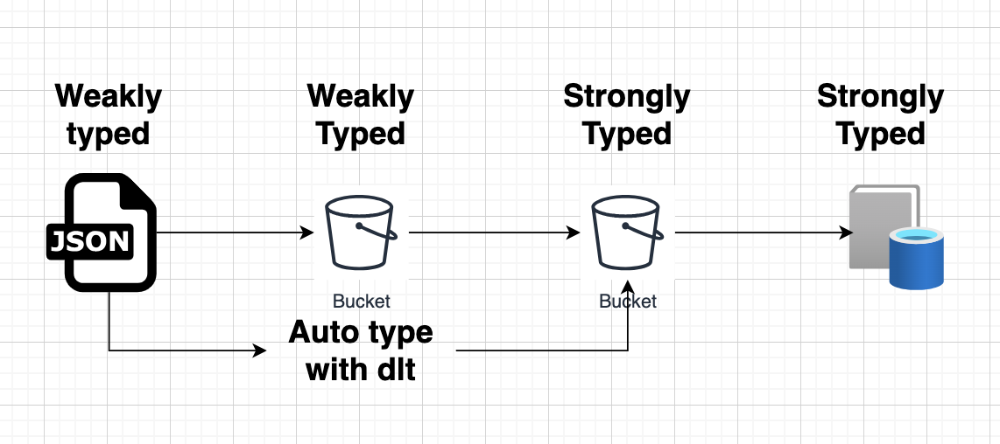

What does Loading to a catalog mean?

1. Copy data to Filesystem Storage
2. Tell catalog what data is available where

Example config:

In [ ]:
[destination.filesystem]
bucket_url = "s3://[your_bucket_name]" # replace with your bucket name,

[destination.filesystem.credentials]
aws_access_key_id = "please set me up!" # copy the access key here
aws_secret_access_key = "please set me up!" # copy the secret access key here

[destination.athena]
query_result_bucket="s3://[results_bucket_name]" # replace with your query results bucket name

[destination.athena.credentials]
aws_access_key_id="please set me up!" # same as credentials for filesystem
aws_secret_access_key="please set me up!" # same as credentials for filesystem
region_name="please set me up!" # set your AWS region, for example "eu-central-1" for Frankfurt

Example pipeline to Athena

In [ ]:
pipeline = dlt.pipeline(
    pipeline_name='fs_s3_iceberg_pipeline',
    destination='athena',# <---- Change to Athena. If you do not provide Filesystem, it will be used by default
    staging='filesystem',
    dataset_name='fs_s3_iceberg_data',
)

## Example: Iceberg/Delta partitioning configuration

Partitioning is a way to make read queries faster by grouping similar records together by a "partition key".

Delta uses Hive-style partitioning, while Iceberg uses hidden partioning.

Simple delta example:

In [ ]:
# delta example
@dlt.resource(
  table_format="delta",
  columns={"foo": {"partition": True}}
)
def paginated_getter():
    ...

Athena adapter for Iceberg Tables:

In [ ]:
from datetime import date

import dlt
from dlt.destinations.adapters import athena_partition, athena_adapter

data_items = [
    (1, "A", date(2021, 1, 1)),
    (2, "A", date(2021, 1, 2)),
    (3, "A", date(2021, 1, 3)),
    (4, "A", date(2021, 2, 1)),
    (5, "A", date(2021, 2, 2)),
    (6, "B", date(2021, 1, 1)),
    (7, "B", date(2021, 1, 2)),
    (8, "B", date(2021, 1, 3)),
    (9, "B", date(2021, 2, 1)),
    (10, "B", date(2021, 3, 2)),
]

@dlt.resource(table_format="iceberg")
def partitioned_data():
    yield [{"id": i, "category": c, "created_at": d} for i, c, d in data_items]

# Add partitioning hints to the table
athena_adapter(
    partitioned_data,
    partition=[
        # Partition per category and month
        "category",
        athena_partition.month("created_at"),
    ],
)


pipeline = dlt.pipeline("athena_example")
pipeline.run(partitioned_data)

# Loading to Data Warehouses/MPPs

Differently from Data lakes and Lakehouses, Data warehouses are most like a traditional database.

They are services that use multiple machines in a cluster to get the work done at larger scale.

They shine at columnar operations, like aggregations, which are typical operations in a serving/analytics layer.

However due to to their columnar storage they are not optimal for lateral operations (the T in ETL). Nevertheless, due to their accessibility and scale, they are widely used as a compute engine for transformations.

## Understanding staging

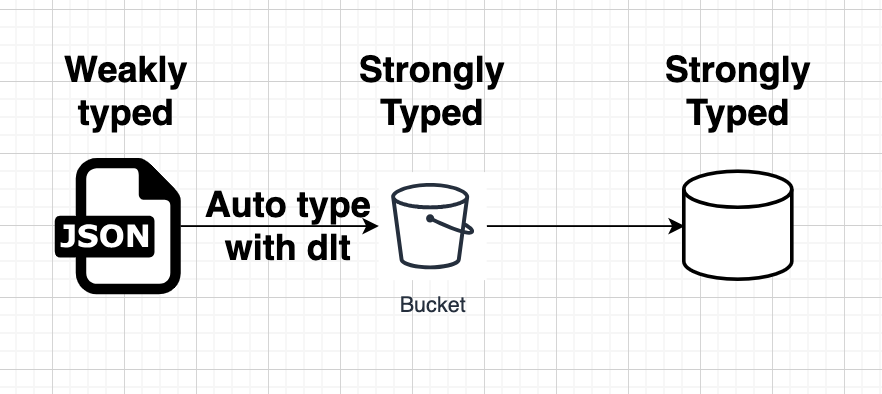

MPP "massive parallel processing" databases usually have a leader node that interprets SQL and communicates a plan downstreeam to a number of compute nodes.

The slow way of loading data is to pass it to the leader node in SQL as insert statements.

The faster way to load data is to make it available to the compute nodes and let them grab it. For this purpose, MPPs recommend using a staging layer for this data. The data is then loaded with "COPY" queries or api calls dependng on vendor.

The staging layer is handled differently from one vendor to the next - for example,
- For Bigquery, we can stage the data on our local machine, or online.
- For Redshift, we may only stage data online, requiring extra configuration.

### What is staging?
Typically Staging is a cloud bucket destination - no different from a data lake. From there, the MPP can tell the leader nodes to read the data.

Setting up staging simply means adding a filesystem (data lake) destination as an in-between step, and dlt will load data to the final destination through it.

### Examples

In [ ]:
# BigQuery/GCS staging example
# Create a dlt pipeline that will load
# chess player data to the BigQuery destination
# via a GCS bucket.
pipeline = dlt.pipeline(
    pipeline_name='chess_pipeline',
    destination='bigquery',
    staging='filesystem', # <- For bigquery, we choose between implicit or explcit staging
    dataset_name='player_data'
)

In [ ]:
# Redshift/S3 staging example code
# Create a dlt pipeline that will load
# chess player data to the Redshift destination
# via staging on S3
pipeline = dlt.pipeline(
    pipeline_name='chess_pipeline',
    destination='redshift',
    staging='filesystem', # <- For Redshift, we use staging, or we default to slow insert via leader node.
    dataset_name='player_data'
)

## Hybrid modes - External tables, external staging

Data warehouse technology follows the same priciples from vendor to vendor but can be very different in practice.


### External tables
For example, we can load "external" tables to data warehouses - which is the same as loading data to Storage and then registering it in a catalog - except, now the catalog is the DWH.

### External staging
- Some techs like Redshift require that staging is online
- Bigquery API supports loading directly from local stage without requiring an online bucket.

## Example: Load to Bigquery

First, install the dependencies, define the source, then change the destination name and run the pipeline.

Let's use our GitHub API and load data from the source into destination.

In [ ]:
%%capture
!pip install dlt[bigquery]

In [ ]:
import os
import dlt
from dlt.sources.helpers.rest_client import RESTClient
from dlt.sources.helpers.rest_client.auth import BearerTokenAuth
from dlt.sources.helpers.rest_client.paginators import HeaderLinkPaginator
from google.colab import userdata

os.environ["ACCESS_TOKEN"] = userdata.get('ACCESS_TOKEN')


@dlt.resource(
    name="events",
    write_disposition="merge",
    primary_key="id",
)
def paginated_getter(
    access_token=dlt.secrets.value,
    cursor_date = dlt.sources.incremental(
        "created_at",
        initial_value="2025-02-25"
    )
):
    client = RESTClient(
        base_url="https://api.github.com/repos/DataTalksClub/data-engineering-zoomcamp/",
        auth=BearerTokenAuth(token=access_token),
        paginator=HeaderLinkPaginator(links_next_key="next"),
    )

    for page in client.paginate("events"):
        yield page


**Set Credentials & destination**  

The next logical step is to [set credentials](https://dlthub.com/docs/general-usage/credentials/) using **dlt's TOML providers** or **environment variables (ENVs)**.


In [ ]:
import os
from google.colab import userdata

os.environ["DESTINATION__BIGQUERY__CREDENTIALS"] = userdata.get('BIGQUERY_CREDENTIALS')

pipeline = dlt.pipeline(
    pipeline_name='github_pipeline_merge',
    destination="bigquery", # <--- new destination
    dataset_name="events_dataset",
)


load_info = pipeline.run(paginated_getter)
print(pipeline.last_trace)

# Deployment and orchestration

###Deploy a pipeline with GitHub Actions <br>
Docs: https://dlthub.com/docs/walkthroughs/deploy-a-pipeline/deploy-with-github-actions <br>


###Deploy a pipeline with Airflow & Google Composer
Docs: https://dlthub.com/docs/walkthroughs/deploy-a-pipeline/deploy-with-airflow-composer

###Deploy a pipeline with Dagster
Docs: https://dlthub.com/docs/walkthroughs/deploy-a-pipeline/deploy-with-dagster

# Create pipelines with AI/LLMs using Cursor

## Understanding Cursor
- Cursor is an AI-powered IDE built on Visual Studio Code that accelerates your workflow by integrating intelligent features into a familiar editor.
- This enables you to build REST API sources with dlt through prompt-based code generation, clear handling of parameters (such as endpoints, authentication, and pagination), and real-time code validation.

- This produces self-documenting, self-maintaining, and easy to troubleshoot sources.

##Adding rules to cursor

We bundled a set of cursor rules that help building REST API pipelines with dlt. To use them, you should start by [initializing a new dlt project](https://dlthub.com/docs/walkthroughs/create-a-pipeline):<br>
`dlt init rest_api duckdb`

This will add `rest_api_pipeline.py` to your current folder with pretty detailed usage examples. We see improvements in generated code if this file is added to the cursor agent context.<br>

Now you can add a set of project rules we use to develop REST API sources:<br>
`dlt ai setup cursor`

- They are pretty useful when converting OpenAPI specs or legacy source code into dlt pipelines. <br>
- Some rules are always included, others are triggered by the agent based on their descriptions. <br>
- You can review your project rules by looking in .cursor/rules folder or in Cursor Settings >> Rules. <br>

##Configuring Cursor with documentation

Under Cursor Settings > Features > Docs, you will see the docs you have added. You can edit, delete, or add new docs here.

We recommend adding documentation scoped for specific task. Here you may try:

REST API Source documentation: https://dlthub.com/docs/dlt-ecosystem/verified-sources/rest_api/ <br>
Core dlt concepts & usage: https://dlthub.com/docs/general-usage/resource (optional)

##Model and context selection

We had best results with Claude 3.7-sonnet (which requires paid version of Cursor). Weaker models were not able to comprehend the required context in full and were not able to use tools and follow workflows consistently.

We typically put the following in the context:

- docs: REST API Source documentation
- example rest_api_pipeline.py
- yaml definitions, openAPI specs or references to files implementing legacy data source
- API Clients or SDKs

##Running the workflow

Find detail documentation on running a workflow in Cursor here: https://dlthub.com/docs/dlt-ecosystem/llm-tooling/cursor-restapi#22-adding-rules-to-cursor

That’s it! 🎉
Thank you for taking the course Data Engineering with Python and AI/LLMs. We hope you enjoyed the learning experience. Now, take the quiz to solidify your understanding and earn your certificate!